## Reading Dataset

In [1]:
from utils.agent import *
from utils.dataset import read_voc_dataset
from IPython.display import clear_output
import tqdm.notebook as tq
import time
%reload_ext autoreload
%autoreload 2

In [2]:
train_loader2007, val_loader2007 = read_voc_dataset(path="." ,year='2007')
# train_loader2012, val_loader2012 = read_voc_dataset(path="." ,year='2012')

Using downloaded and verified file: ./VOCtrainval_06-Nov-2007.tar
Extracting ./VOCtrainval_06-Nov-2007.tar to .
Using downloaded and verified file: ./VOCtrainval_06-Nov-2007.tar
Extracting ./VOCtrainval_06-Nov-2007.tar to .


## Dataset Organization

In [3]:
#put datalist in list in case of combination of different datasets
#For example: [train_loader2007, train_loader2012]
datasets_per_class = sort_class_extract([train_loader2007])

  0%|          | 0/2501 [00:00<?, ?it/s]

## Training Loop

In [4]:
# trian all
loss_list = None
for i in tq.tqdm(range(len(classes))):
    classe = classes[i]
    print("Classe "+str(classe)+"...")
    agent = Agent(classe, alpha=0.2, num_episodes=20, load=False, model_name='vgg16')
    agent.train(datasets_per_class[classe], verbose=False)
    loss_list = agent.loss_record
    del agent
    torch.cuda.empty_cache()

  0%|          | 0/5 [00:00<?, ?it/s]

Classe cat...
Episode 0
Saved
Complete
Episode 1
Saved
Complete
Episode 2
Saved
Complete
Episode 3
Saved
Complete
Episode 4
Saved
Complete
Episode 5
Saved
Complete
Episode 6
Saved
Complete
Episode 7
Saved
Complete
Episode 8
Saved
Complete
Episode 9
Saved
Complete
Episode 10
Saved
Complete
Episode 11
Saved
Complete
Episode 12
Saved
Complete
Episode 13
Saved
Complete
Episode 14
Saved
Complete
Episode 15
Saved
Complete
Episode 16
Saved
Complete
Episode 17
Saved
Complete
Episode 18
Saved
Complete
Episode 19
Saved
Complete
Classe cow...
Episode 0
Saved
Complete
Episode 1
Saved
Complete
Episode 2
Saved
Complete
Episode 3
Saved
Complete
Episode 4
Saved
Complete
Episode 5
Saved
Complete
Episode 6
Saved
Complete
Episode 7
Saved
Complete
Episode 8
Saved
Complete
Episode 9
Saved
Complete
Episode 10
Saved
Complete
Episode 11
Saved
Complete
Episode 12
Saved
Complete
Episode 13
Saved
Complete
Episode 14
Saved
Complete
Episode 15
Saved
Complete
Episode 16
Saved
Complete
Episode 17
Saved
Complete
Epis

TypeError: unsupported operand type(s) for -: 'builtin_function_or_method' and 'float'

In [49]:
# train cow
loss_list = None
classe = 'cow'
print("Classe "+str(classe)+"...")
agent = Agent(classe, alpha=0.2, num_episodes=20, load=False, model_name='vgg16')
agent.train(datasets_per_class[classe], verbose=False)
loss_list = agent.loss_record
del agent
torch.cuda.empty_cache()

Classe cow...
Episode 0
Saved
Complete
Episode 1
Saved
Complete
Episode 2
Saved
Complete
Episode 3
Saved
Complete
Episode 4
Saved
Complete
Episode 5
Saved
Complete
Episode 6
Saved
Complete
Episode 7
Saved
Complete
Episode 8
Saved
Complete
Episode 9
Saved
Complete
Episode 10
Saved
Complete
Episode 11
Saved
Complete
Episode 12
Saved
Complete
Episode 13
Saved
Complete
Episode 14
Saved
Complete
Episode 15
Saved
Complete
Episode 16
Saved
Complete
Episode 17
Saved
Complete
Episode 18
Saved
Complete
Episode 19
Saved
Complete


In [7]:
# Test on whole dataset to get result metrics
torch.cuda.empty_cache()
results = {}
for i in classes:
    results[i] = []
model_name='vgg16'
for i in tq.tqdm(range(len(classes))):
    classe = classes[i]
    print("Class "+str(classe)+"...")
    agent = Agent(classe, load=True, model_name=model_name)
    res = agent.evaluate(datasets_per_class[classe])
    results[classe] = res

  0%|          | 0/5 [00:00<?, ?it/s]

Class cat...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      67.780749
recall  83.246073
Class cow...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      12.770240
recall  34.054054
Class dog...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      32.915763
recall  72.693727
Class bird...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      47.466922
recall  57.482993
Class car...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      18.634854
recall  39.830508


In [6]:
datasets_per_class_val = sort_class_extract([val_loader2007])

torch.cuda.empty_cache()
results = {}
for i in classes:
    results[i] = []
model_name='vgg16'
for i in tq.tqdm(range(len(classes))):
    classe = classes[i]
    print("Class "+str(classe)+"...")
    agent = Agent(classe, load=True, model_name=model_name)
    res = agent.evaluate(datasets_per_class_val[classe])
    results[classe] = res

  0%|          | 0/2510 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

Class cat...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      42.745037
recall  46.969697
Class cow...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      10.246107
recall  13.450292
Class dog...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      32.632685
recall  41.947566
Class bird...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      17.508418
recall  16.393443
Class car...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      15.541472
recall  23.105134


In [4]:
cow_dataset = datasets_per_class['cow']

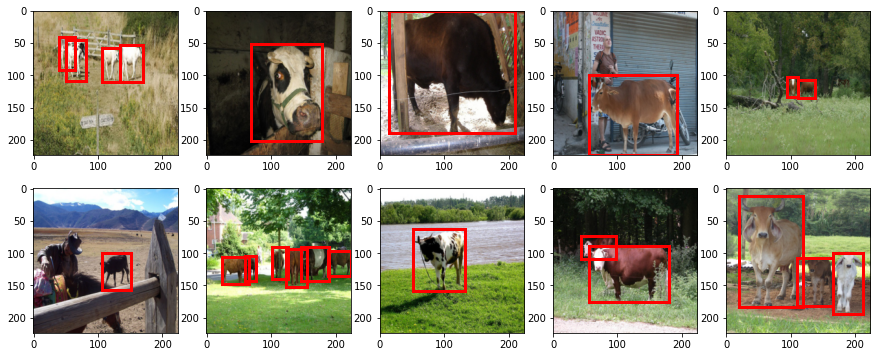

In [42]:
t = 1
plt.figure(figsize=[15,6])
indexes = []
for i in list(cow_dataset.keys())[:10]:
    indexes.append(i)
    image = cow_dataset[i][0][0]
    plt.subplot(2,5,t)
    plt.imshow(image.permute([1,2,0]))
    
    for j in range(1,len(cow_dataset[i][0])):
        gt = cow_dataset[i][0][j][0]
        image_size = cow_dataset[i][0][j][1]
    
        origin_width, origin_height = int(image_size['width']), int(image_size['height'])
        real_width, real_height = 224, 224
        width_ratio, height_ratio = real_width/origin_width, real_height/origin_height

        bdbox = np.array([gt['xmin'], gt['ymin'], gt['xmax'], gt['ymax']]).astype('float')
        bdbox = (bdbox * [width_ratio, height_ratio, width_ratio, height_ratio]).astype('int')

    
        plt.gca().add_patch(plt.Rectangle((bdbox[0], bdbox[1]), 
                                          bdbox[2]-bdbox[0], bdbox[3]-bdbox[1], 
                                          fill=False, edgecolor='r', linewidth=3))
    t += 1

Iteration:1 - Action:4 - Position:[0, 224, 44.800000000000004, 224]
Iteration:2 - Action:4 - Position:[0, 224, 80.64, 224]
Iteration:3 - Action:7 - Position:[0, 224, 109.31200000000001, 195.328]
Iteration:4 - Action:3 - Position:[0, 224, 92.10880000000002, 178.1248]
Iteration:5 - Action:7 - Position:[0, 224, 109.31200000000001, 160.9216]
Iteration:6 - Action:3 - Position:[0, 224, 98.99008, 150.59968]
Iteration:7 - Action:7 - Position:[0, 224, 109.31200000000001, 140.27776]
Iteration:8 - Action:3 - Position:[0, 224, 103.11884800000001, 134.084608]
Iteration:9 - Action:1 - Position:[44.800000000000004, 224, 103.11884800000001, 134.084608]
Iteration:10 - Action:1 - Position:[80.64, 224, 103.11884800000001, 134.084608]
Iteration:11 - Action:5 - Position:[51.967999999999996, 224, 96.92569600000002, 140.27776]
Iteration:12 - Action:1 - Position:[86.37440000000001, 224, 96.92569600000002, 140.27776]
Iteration:13 - Action:5 - Position:[58.84928000000001, 224, 88.25528320000002, 148.9481728]
It

Iteration:6 - Action:3 - Position:[30, 224, 111.75935999999999, 145.28256000000002]
Iteration:7 - Action:8 - Position:[68.80000000000001, 185.2, 111.75935999999999, 145.28256000000002]
Iteration:8 - Action:5 - Position:[45.52000000000001, 208.48, 105.05471999999997, 151.98720000000003]
Iteration:9 - Action:5 - Position:[12.928000000000011, 224, 95.66822399999997, 161.37369600000005]
Iteration:10 - Action:7 - Position:[12.928000000000011, 224, 108.80931839999998, 148.23260160000004]
Iteration:11 - Action:2 - Position:[0, 181.7856, 108.80931839999998, 148.23260160000004]
Iteration:12 - Action:2 - Position:[0, 145.42847999999998, 108.80931839999998, 148.23260160000004]
Iteration:13 - Action:8 - Position:[29.085696, 116.34278399999998, 108.80931839999998, 148.23260160000004]
Iteration:14 - Action:3 - Position:[29.085696, 116.34278399999998, 100.92466175999996, 140.34794496000004]
Iteration:15 - Action:5 - Position:[11.634278400000003, 133.79420159999998, 93.04000511999995, 148.232601600000

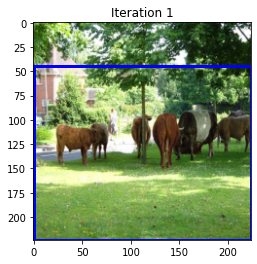

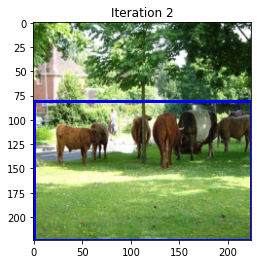

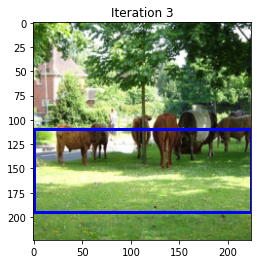

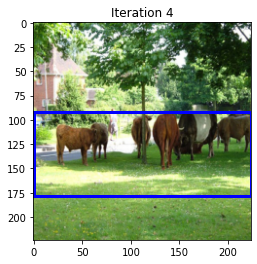

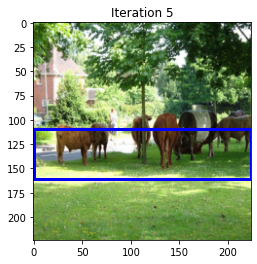

...

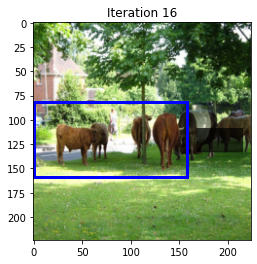

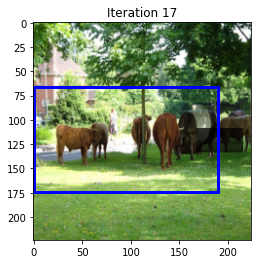

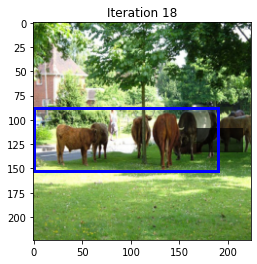

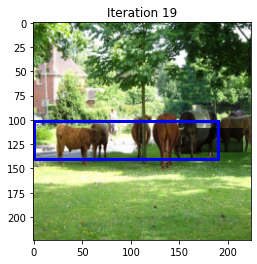

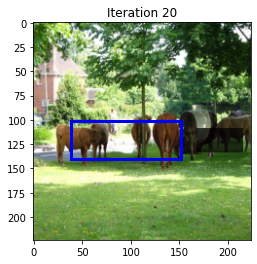

In [45]:
model_name='vgg16'
classe = 'cow'
agent = Agent(classe, load=True, model_name=model_name)
# Test on signle picture to visualize the process of prediction
i = 6
for index in indexes[i:i+1]:
    image, gt_boxes = extract(index, datasets_per_class[classe])
    bdboxes = agent.predict_multiple_objects(image, plot=True, verbose=True)

In [36]:
cat_dataset = datasets_per_class['cat']

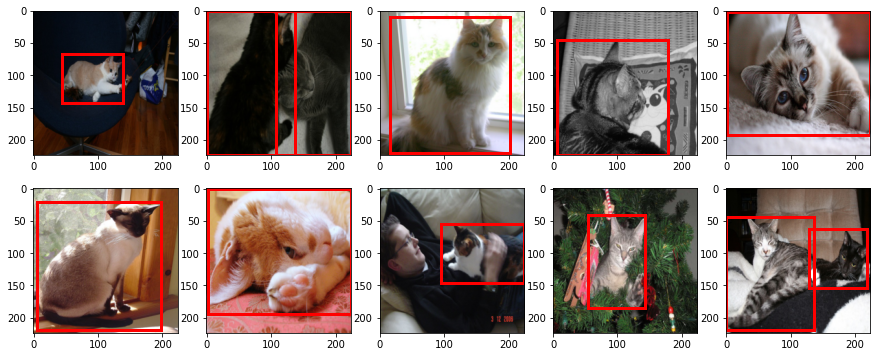

In [46]:
t = 1
plt.figure(figsize=[15,6])
indexes = []
for i in list(cat_dataset.keys())[:10]:
    indexes.append(i)
    image = cat_dataset[i][0][0]
    plt.subplot(2,5,t)
    plt.imshow(image.permute([1,2,0]))
    
    for j in range(1,len(cat_dataset[i][0])):
        gt = cat_dataset[i][0][j][0]
        image_size = cat_dataset[i][0][j][1]
    
        origin_width, origin_height = int(image_size['width']), int(image_size['height'])
        real_width, real_height = 224, 224
        width_ratio, height_ratio = real_width/origin_width, real_height/origin_height

        bdbox = np.array([gt['xmin'], gt['ymin'], gt['xmax'], gt['ymax']]).astype('float')
        bdbox = (bdbox * [width_ratio, height_ratio, width_ratio, height_ratio]).astype('int')

    
        plt.gca().add_patch(plt.Rectangle((bdbox[0], bdbox[1]), 
                                          bdbox[2]-bdbox[0], bdbox[3]-bdbox[1], 
                                          fill=False, edgecolor='r', linewidth=3))
    t += 1

Iteration:1 - Action:0 - Position:[0, 224, 0, 224]
Iteration:1 - Action:4 - Position:[0, 224, 44.800000000000004, 224]
Iteration:2 - Action:4 - Position:[0, 224, 80.64, 224]
Iteration:3 - Action:4 - Position:[0, 224, 109.31200000000001, 224]
Iteration:4 - Action:4 - Position:[0, 224, 132.24960000000002, 224]
Iteration:5 - Action:2 - Position:[0, 179.2, 132.24960000000002, 224]
Iteration:6 - Action:5 - Position:[0, 215.04, 113.89952000000002, 224]
Iteration:7 - Action:4 - Position:[0, 215.04, 135.91961600000002, 224]
Iteration:8 - Action:2 - Position:[0, 172.03199999999998, 135.91961600000002, 224]
Iteration:9 - Action:5 - Position:[0, 206.43839999999997, 118.30353920000002, 224]
Iteration:10 - Action:4 - Position:[0, 206.43839999999997, 139.44283136, 224]
Iteration:11 - Action:2 - Position:[0, 165.15071999999998, 139.44283136, 224]
Iteration:12 - Action:5 - Position:[0, 198.18086399999999, 122.53139763200002, 224]
Iteration:13 - Action:4 - Position:[0, 198.18086399999999, 142.825118105

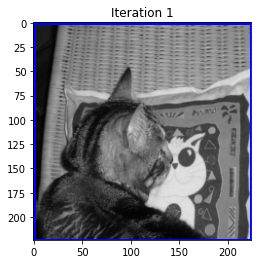

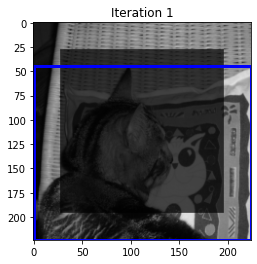

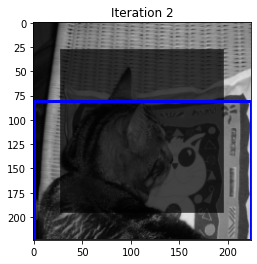

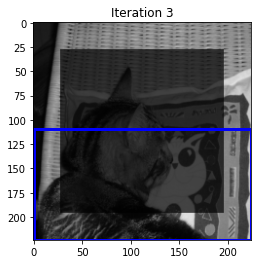

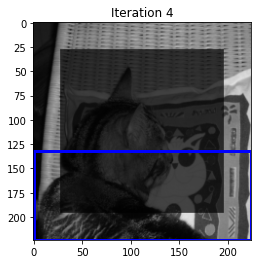

...

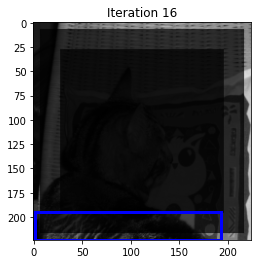

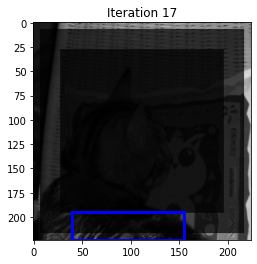

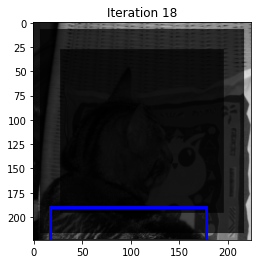

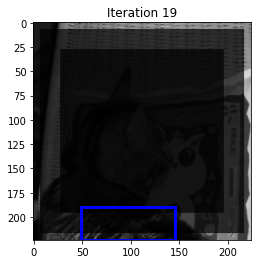

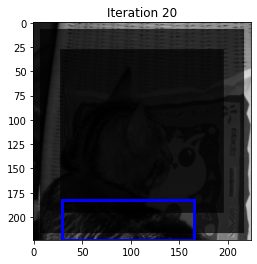

In [50]:
model_name='vgg16'
classe = 'cat'
agent = Agent(classe, load=True, model_name=model_name)
# Test on signle picture to visualize the process of prediction
i = 3
for index in indexes[i:i+1]:
    image, gt_boxes = extract(index, datasets_per_class[classe])
    bdboxes = agent.predict_multiple_objects(image, plot=True, verbose=True)

In [49]:
bdboxes

[[0, 224, 0, 224]]

# Get Stat

In [13]:
# Test on whole dataset to get result metrics
torch.cuda.empty_cache()
classe = 'cow'
model_name='vgg16'
print("Class "+str(classe)+"...")
agent = Agent(classe, load=True, model_name=model_name)
res = agent.evaluate(cow_dataset)
res

Class cow...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      26.545455
recall  28.108108


,0.5
ap,26.545455
recall,28.108108


In [51]:
torch.cuda.empty_cache()
model_name='vgg16'
agent = Agent(classe, load=True, model_name=model_name)
res = agent.evaluate(datasets_per_class_val['cat'])

Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      52.144622
recall  50.000000


In [17]:
len(datasets_per_class_val)

5

In [16]:
datasets_per_class_val = sort_class_extract([val_loader2007])

  0%|          | 0/2510 [00:00<?, ?it/s]

In [18]:
torch.cuda.empty_cache()
model_name='vgg16'
agent = Agent(classe, load=True, model_name=model_name)
res = agent.evaluate(datasets_per_class_val['cow'])

Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      17.703349
recall  10.526316


In [33]:
torch.cuda.empty_cache()
model_name='vgg16'
agent = Agent(classe, load=True, model_name=model_name)
res = agent.evaluate(datasets_per_class_val['cow'])

Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      17.868339
recall  16.374269


In [ ]:
datasets_per_class_val = sort_class_extract([val_loader2007])

torch.cuda.empty_cache()
results = {}
for i in classes:
    results[i] = []
model_name='vgg16'
for i in tq.tqdm(range(len(classes))):
    classe = classes[i]
    print("Class "+str(classe)+"...")
    agent = Agent(classe, load=True, model_name=model_name)
    res = agent.evaluate(datasets_per_class_val[classe])
    results[classe] = res

  0%|          | 0/2510 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

Class cat...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      52.144622
recall  50.000000
Class cow...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      17.272727
recall  16.959064
Class dog...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.5
ap      43.547755
recall  44.943820
Class bird...
Predicting boxes...
